In [1]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns

In [2]:
# Plot style
sns.set()
%pylab inline
pylab.rcParams['figure.figsize'] = (4, 4)
# Avoid inaccurate floating values (for inverse matrices in dot product for instance)
# See https://stackoverflow.com/questions/24537791/numpy-matrix-inversion-rounding-errors
np.set_printoptions(suppress=True)

%pylab is deprecated, use %matplotlib inline and import the required libraries.
Populating the interactive namespace from numpy and matplotlib


In [3]:
def plotVectors(vecs, cols, alpha=1):
    """
    Plot set of vectors.

    Parameters
    ----------
    vecs : array-like
        Coordinates of the vectors to plot. Each vectors is in an array. For
        instance: [[1, 3], [2, 2]] can be used to plot 2 vectors.
    cols : array-like
        Colors of the vectors. For instance: ['red', 'blue'] will display the
        first vector in red and the second in blue.
    alpha : float
        Opacity of vectors

    Returns:

    fig : instance of matplotlib.figure.Figure
        The figure of the vectors
    """
    plt.axvline(x=0, color='#A9A9A9', zorder=0)
    plt.axhline(y=0, color='#A9A9A9', zorder=0)

    for i in range(len(vecs)):
        if (isinstance(alpha, list)):
            alpha_i = alpha[i]
        else:
            alpha_i = alpha
        x = np.concatenate([[0,0],vecs[i]])
        plt.quiver([x[0]],
                   [x[1]],
                   [x[2]],
                   [x[3]],
                   angles='xy', scale_units='xy', scale=1, color=cols[i],
                  alpha=alpha_i)

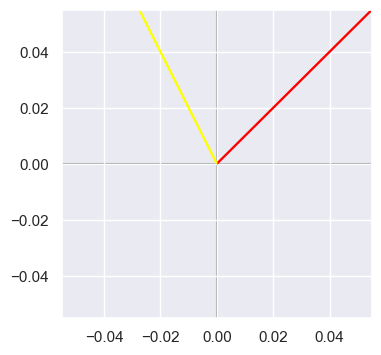

In [4]:
plotVectors(np.array([[1,1], [-1,2]]),['red', 'yellow'],alpha=1)

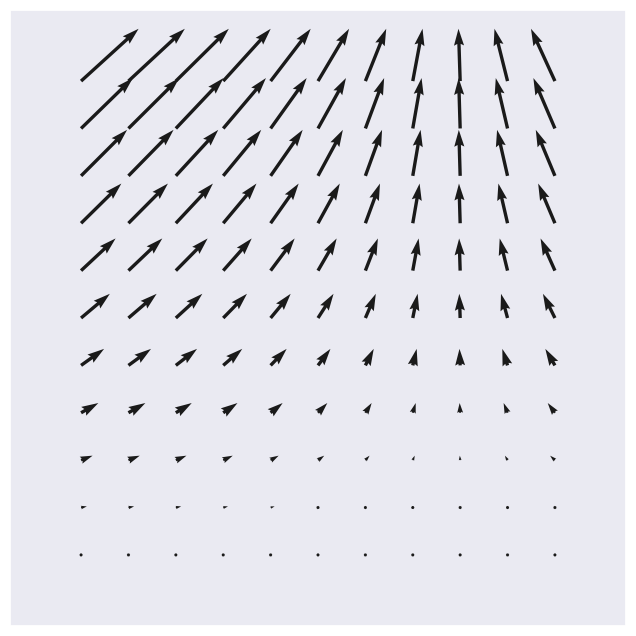

In [5]:
# Import libraries
import numpy as np
import matplotlib.pyplot as plt


# Creating arrow
x = np.arange(0, 2.2, 0.2)
y = np.arange(0, 2.2, 0.2)

X, Y = np.meshgrid(x, y)
u = np.cos(X)*Y
v = np.sin(Y)*Y

# creating plot
fig, ax = plt.subplots(figsize =(14, 8))
ax.quiver(X, Y, u, v)

ax.xaxis.set_ticks([])
ax.yaxis.set_ticks([])
ax.axis([-0.3, 2.3, -0.3, 2.3])
ax.set_aspect('equal')

# show plot
plt.show()


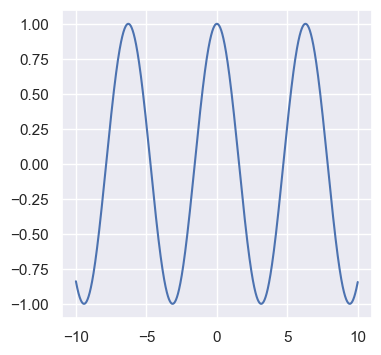

In [6]:
x = np.arange(-10, 10, 0.01)
y= np.cos(1*x)
plt.plot(x,y)

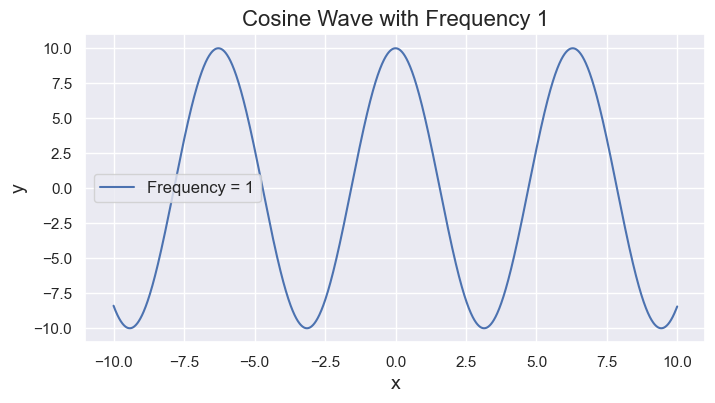

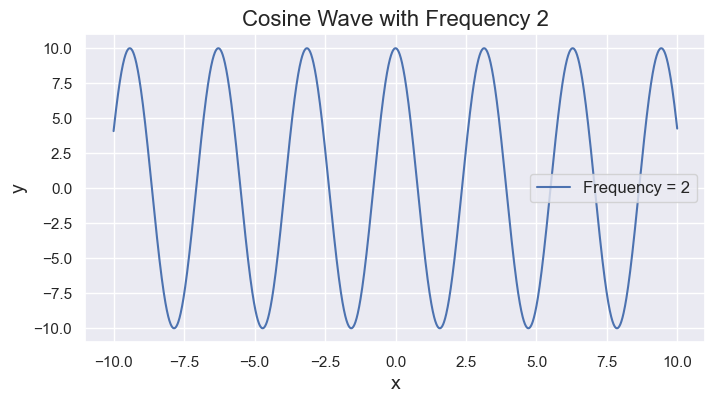

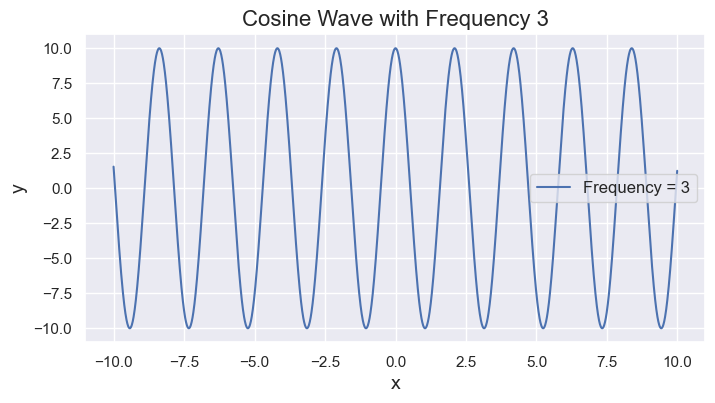

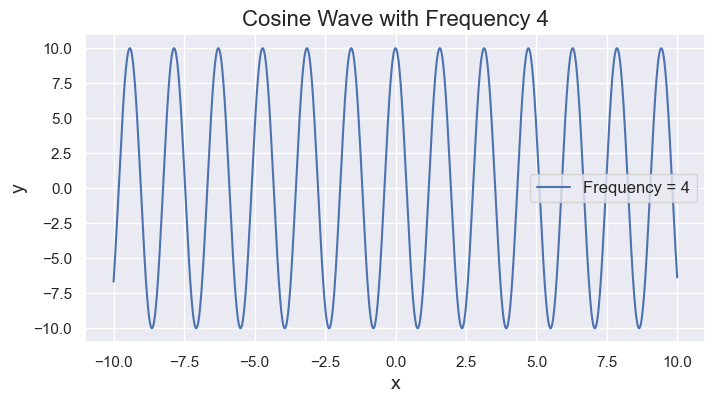

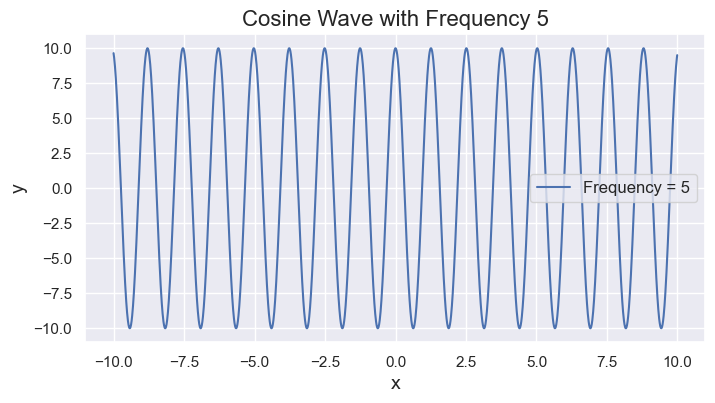

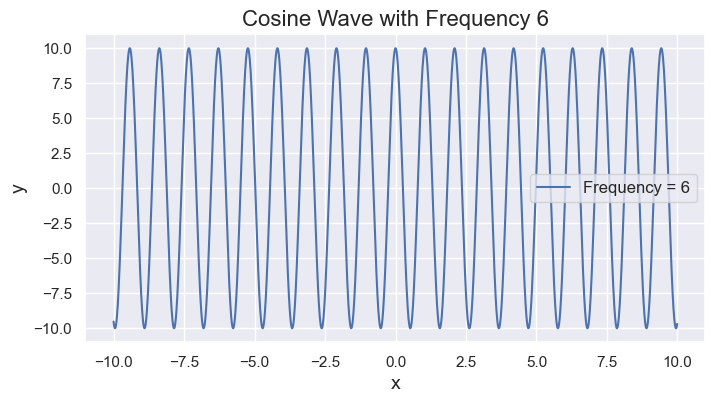

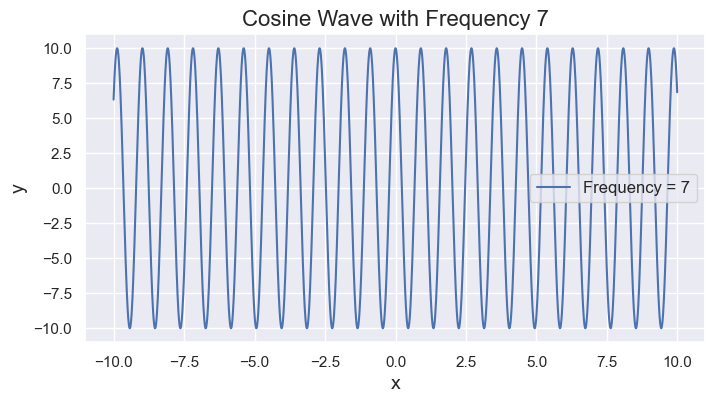

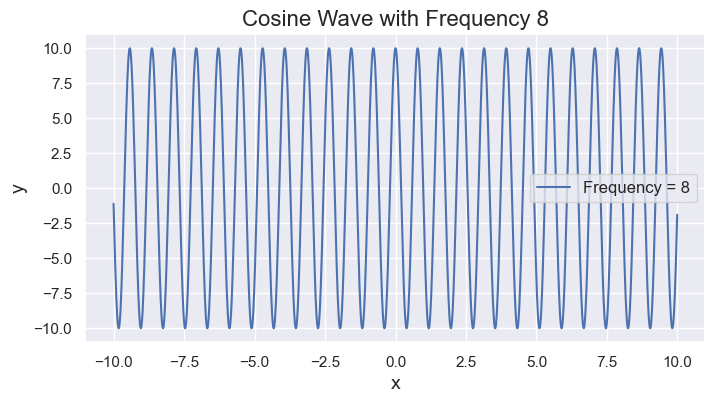

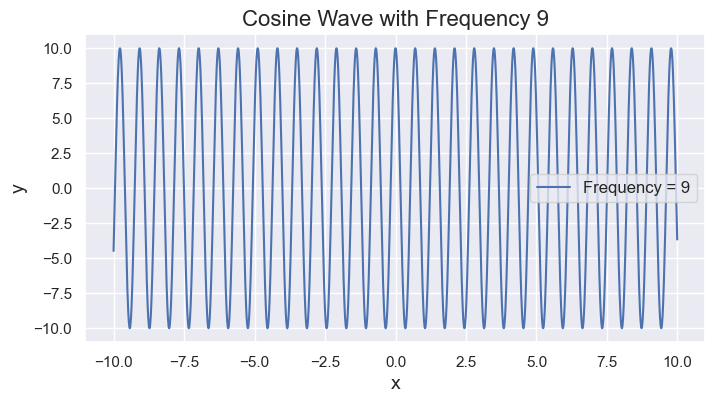

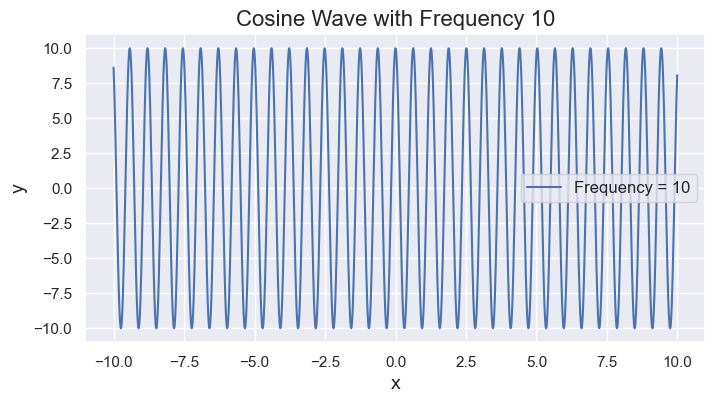

In [7]:
import numpy as np
import matplotlib.pyplot as plt

# Define the x range
x = np.arange(-10, 10, 0.01)

# Generate and plot 10 independent graphs with varying frequencies
for i, freq in enumerate(range(1, 11), start=1):  # Frequencies from 1 to 10
    y = 10 * np.cos(freq * x)  # Cosine wave with varying frequency
    plt.figure(figsize=(8, 4))
    plt.plot(x, y, label=f'Frequency = {freq}')
    plt.title(f'Cosine Wave with Frequency {freq}', fontsize=16)
    plt.xlabel('x', fontsize=14)
    plt.ylabel('y', fontsize=14)
    plt.legend(fontsize=12)
    plt.grid(True)
    plt.show()

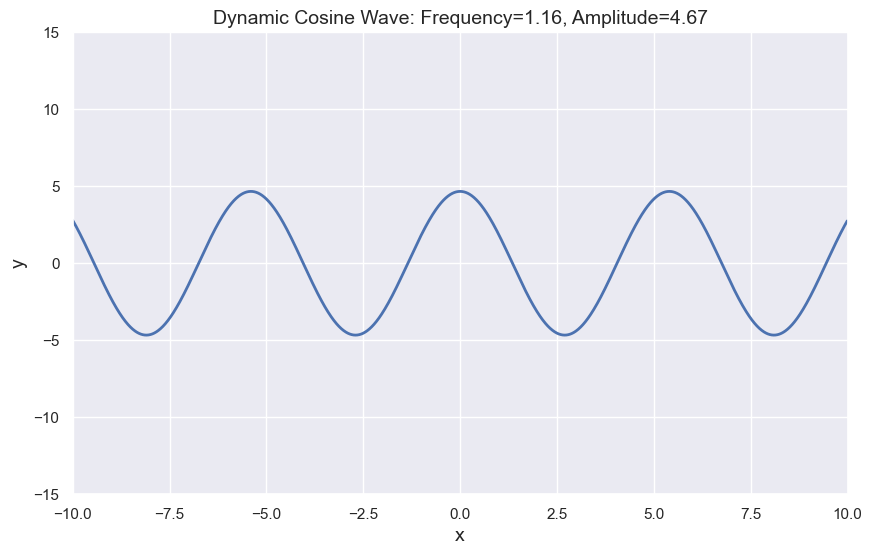

In [8]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Define the x range
x = np.arange(-10, 10, 0.01)

# Initialize the figure and line object
fig, ax = plt.subplots(figsize=(10, 6))
line, = ax.plot([], [], lw=2)

# Set up the plot
ax.set_xlim(-10, 10)
ax.set_ylim(-15, 15)
ax.set_title('Dynamic Cosine Wave with Random Frequency and Amplitude', fontsize=16)
ax.set_xlabel('x', fontsize=14)
ax.set_ylabel('y', fontsize=14)
ax.grid(True)

# Initialization function for the animation
def init():
    line.set_data([], [])
    return line,

# Update function for the animation
def update(frame):
    # Generate random frequency and amplitude
    freq = np.random.uniform(1, 10)  # Random frequency between 1 and 10
    amp = np.random.uniform(1, 10)   # Random amplitude between 1 and 10
    # Compute the y values
    y = amp * np.cos(freq * x)
    line.set_data(x, y)
    ax.set_title(f'Dynamic Cosine Wave: Frequency={freq:.2f}, Amplitude={amp:.2f}', fontsize=14)
    return line,

# Create the animation
ani = FuncAnimation(fig, update, frames=100, init_func=init, blit=True, interval=200)

# Display the animation in Jupyter Notebook
HTML(ani.to_jshtml())


In [9]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation, PillowWriter

# Generate an ECG waveform function
def ecg_waveform(t):
    # PQRST waveform simulation
    p_wave = 0.1 * np.sin(2 * np.pi * (t - 0.2) * 3) * np.exp(-((t - 0.2) ** 2) / 0.02)
    q_wave = -0.3 * np.exp(-((t - 0.4) ** 2) / 0.01)
    r_wave = 1.0 * np.exp(-((t - 0.5) ** 2) / 0.005)
    s_wave = -0.5 * np.exp(-((t - 0.6) ** 2) / 0.01)
    t_wave = 0.2 * np.sin(2 * np.pi * (t - 0.8) * 3) * np.exp(-((t - 0.8) ** 2) / 0.02)
    return p_wave + q_wave + r_wave + s_wave + t_wave

# Generate time values
t = np.linspace(0, 10, 1000)  # 10 seconds, 1000 points
ecg_signal = ecg_waveform(t % 2)  # Repeating every 2 seconds

# Initialize the figure
fig, ax = plt.subplots(figsize=(8, 4))
line, = ax.plot([], [], lw=2, color="red")
ax.set_xlim(0, 2)  # Display only 2 seconds at a time
ax.set_ylim(-1.5, 1.5)
ax.set_title("Simulated ECG Waveform", fontsize=14)
ax.set_xlabel("Time (s)", fontsize=12)
ax.set_ylabel("Amplitude", fontsize=12)
ax.grid(True)

# Initialization function
def init():
    line.set_data([], [])
    return line,

# Update function for animation
def update(frame):
    # Gradually fill the graph with the ECG waveform
    visible_t = t[:frame + 1] % 2  # Incrementally show more of the signal
    visible_y = ecg_signal[:frame + 1]
    line.set_data(visible_t, visible_y)
    return line,

# Create the animation
ani = FuncAnimation(fig, update, frames=np.arange(0, len(t)), init_func=init, blit=True, interval=30)

# Save the animation as a GIF (optional)
ani.save("ecg_waveform.gif", writer=PillowWriter(fps=30))

plt.close(fig)


In [10]:
A = np.array([[-1, 3], [2, -2]])
A

array([[-1,  3],
       [ 2, -2]])

In [11]:
v = np.array([[2], [1]])
v

array([[2],
       [1]])

(-1.0, 4.0)

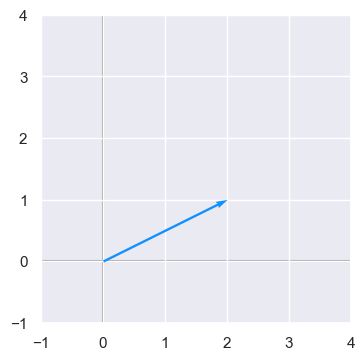

In [12]:
plotVectors([v.flatten()], cols=['#1190FF'])
plt.ylim(-1, 4)
plt.xlim(-1, 4)

[[1]
 [2]]


(-1.0, 4.0)

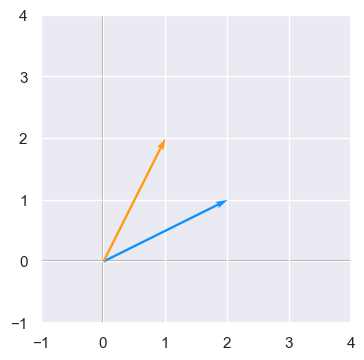

In [13]:
Av = A.dot(v)
print(Av)
plotVectors([v.flatten(), Av.flatten()], cols=['#1190FF', '#FF9A13'])
plt.ylim(-1, 4)
plt.xlim(-1, 4)

In [14]:
A = np.array([[1,2],[3,5]])
B = np.array([[-12,11],[12,34]])
np.dot(A,B)

array([[ 12,  79],
       [ 24, 203]])

Animation size has reached 20985116 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


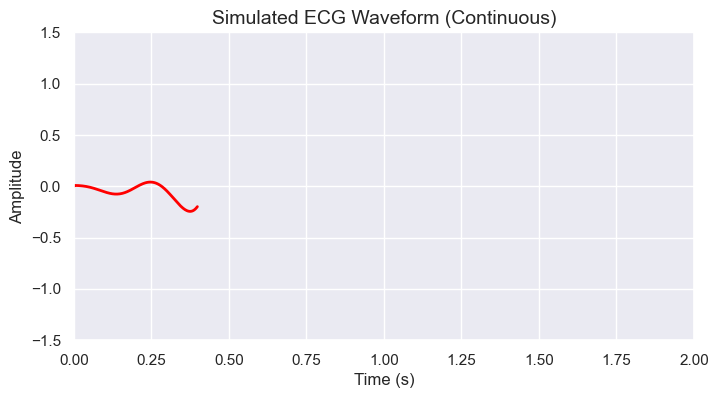

In [37]:
import numpy as np
import matplotlib.pyplot as plt
from matplotlib.animation import FuncAnimation
from IPython.display import HTML

# Generate an ECG waveform function
def ecg_waveform(t):
    # PQRST waveform simulation
    p_wave = 0.1 * np.sin(2 * np.pi * (t - 0.2) * 3) * np.exp(-((t - 0.2) ** 2) / 0.02)
    q_wave = -0.3 * np.exp(-((t - 0.4) ** 2) / 0.01)
    r_wave = 1.0 * np.exp(-((t - 0.5) ** 2) / 0.005)
    s_wave = -0.5 * np.exp(-((t - 0.6) ** 2) / 0.01)
    t_wave = 0.2 * np.sin(2 * np.pi * (t - 0.8) * 3) * np.exp(-((t - 0.8) ** 2) / 0.02)
    return p_wave + q_wave + r_wave + s_wave + t_wave

# Generate time values
t = np.linspace(0, 2, 1000)  # 2 seconds, 1000 points
ecg_signal = ecg_waveform(t)

# Extend the signal for continuity
extended_signal = np.tile(ecg_signal, 3)  # Repeat the signal 3 times
extended_t = np.linspace(0, 6, len(extended_signal))  # Adjust time values accordingly

# Initialize the figure
fig, ax = plt.subplots(figsize=(8, 4))
line, = ax.plot([], [], lw=2, color="red")
ax.set_xlim(0, 2)  # Display only 2 seconds at a time
ax.set_ylim(-1.5, 1.5)
ax.set_title("Simulated ECG Waveform (Continuous)", fontsize=14)
ax.set_xlabel("Time (s)", fontsize=12)
ax.set_ylabel("Amplitude", fontsize=12)
ax.grid(True)

# Initialization function
def init():
    line.set_data([], [])
    return line,

# Update function for animation
def update(frame):
    # Calculate visible indices for continuous sliding window
    start = frame % len(ecg_signal)  # Loop through the original signal
    end = start + 200  # Show 2 seconds (200 points)
    visible_t = extended_t[start:end] - extended_t[start]  # Adjust time to start from 0
    visible_y = extended_signal[start:end]
    line.set_data(visible_t, visible_y)
    return line,

# Create the animation
ani = FuncAnimation(fig, update, frames=np.arange(0, len(extended_signal)), init_func=init, blit=True, interval=20)

# Display the animation in Jupyter Notebook
HTML(ani.to_jshtml())
